In [1]:
cd D:/Study/SEM 7/SGP/Mal_URL/

D:\Study\SEM 7\SGP\Mal_URL


In [2]:
!pip install tld

In [3]:
!pip install tldextract

In [72]:
!pip install graphviz

     ---------------------------------------- 0.0/47.0 kB ? eta -:--:--
     ---------------------------------------- 47.0/47.0 kB 2.3 MB/s eta 0:00:00


In [79]:
import pandas as pd
from tld import get_tld, is_tld
import re
from urllib.parse import urlparse
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns
import tldextract
import hashlib
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
from sklearn.tree import DecisionTreeClassifier, export_text, plot_tree
import numpy as np
from sklearn import tree
import graphviz

In [5]:
data = pd.read_csv("malicious_url.csv")

In [6]:
data

,url,type
0,br-icloud.com.br,phishing
1,mp3raid.com/music/krizz_kaliko.html,benign
2,bopsecrets.org/rexroth/cr/1.htm,benign
3,http://www.garage-pirenne.be/index.php?option=...,defacement
4,http://adventure-nicaragua.net/index.php?optio...,defacement
...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware
1048572,http://cbtechrepairs.com/secure/b/,malware
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware


In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 2 columns):
 #   Column  Non-Null Count    Dtype 
---  ------  --------------    ----- 
 0   url     1048575 non-null  object
 1   type    1048575 non-null  object
dtypes: object(2)
memory usage: 16.0+ MB


In [8]:
data.describe()

,url,type
count,1048575,1048575
unique,1037536,4
top,http://style.org.hc360.com/css/detail/mysite/s...,benign
freq,180,760878


In [9]:
data["type"].value_counts()

benign        760878
malware        97129
defacement     96457
phishing       94111
Name: type, dtype: int64

In [10]:
data["url_type"] = data["type"].replace({
    'benign':0,
    'defacement':1,
    'phishing':2,
    'malware':3
});

In [11]:
data

,url,type,url_type
0,br-icloud.com.br,phishing,2
1,mp3raid.com/music/krizz_kaliko.html,benign,0
2,bopsecrets.org/rexroth/cr/1.htm,benign,0
3,http://www.garage-pirenne.be/index.php?option=...,defacement,1
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1
...,...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware,3
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware,3
1048572,http://cbtechrepairs.com/secure/b/,malware,3
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware,3


In [12]:
data['url'] = data['url'].replace('www.', '', regex=True)

In [13]:
data

,url,type,url_type
0,br-icloud.com.br,phishing,2
1,mp3raid.com/music/krizz_kaliko.html,benign,0
2,bopsecrets.org/rexroth/cr/1.htm,benign,0
3,http://garage-pirenne.be/index.php?option=com_...,defacement,1
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1
...,...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware,3
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware,3
1048572,http://cbtechrepairs.com/secure/b/,malware,3
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware,3


In [14]:
def get_url_length(url):
    return len(url)

In [15]:
data['url_len'] = data['url'].apply(lambda x: get_url_length(str(x)))

In [16]:
data

,url,type,url_type,url_len
0,br-icloud.com.br,phishing,2,16
1,mp3raid.com/music/krizz_kaliko.html,benign,0,35
2,bopsecrets.org/rexroth/cr/1.htm,benign,0,31
3,http://garage-pirenne.be/index.php?option=com_...,defacement,1,84
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1,235
...,...,...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware,3,68
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware,3,61
1048572,http://cbtechrepairs.com/secure/b/,malware,3,34
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware,3,70


In [17]:
def extract_pri_domain(url):
    try:
        res = get_tld(url, as_object = True, fail_silently=False,fix_protocol=True)
        pri_domain= res.parsed_url.netloc
    except :
        pri_domain= None
    return pri_domain

In [18]:
data['pri_domain'] = data['url'].apply(lambda x: extract_pri_domain(x))

In [19]:
data

,url,type,url_type,url_len,pri_domain
0,br-icloud.com.br,phishing,2,16,br-icloud.com.br
1,mp3raid.com/music/krizz_kaliko.html,benign,0,35,mp3raid.com
2,bopsecrets.org/rexroth/cr/1.htm,benign,0,31,bopsecrets.org
3,http://garage-pirenne.be/index.php?option=com_...,defacement,1,84,garage-pirenne.be
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1,235,adventure-nicaragua.net
...,...,...,...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware,3,68,paypalsupports.com
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware,3,61,kids4mo.com
1048572,http://cbtechrepairs.com/secure/b/,malware,3,34,cbtechrepairs.com
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware,3,70,alpinebutterfly.com


In [20]:
def count_letters(url):
    num_letters = sum(char.isalpha() for char in url)
    return num_letters

def count_digits(url):
    num_digits = sum(char.isdigit() for char in url)
    return num_digits
def count_special_chars(url):
    special_chars = "!@#$%^&*()_+-=[]{};:,.<>/?`~|"
    num_special_chars = sum(char in special_chars for char in url)
    return num_special_chars

In [21]:
data['letters_count'] = data['url'].apply(lambda x: count_letters(x))
data['digits_count']  = data['url'].apply(lambda x: count_digits(x))
data['special_chars_count']  = data['url'].apply(lambda x: count_special_chars(x))

In [22]:
data

,url,type,url_type,url_len,pri_domain,letters_count,digits_count,special_chars_count
0,br-icloud.com.br,phishing,2,16,br-icloud.com.br,13,0,3
1,mp3raid.com/music/krizz_kaliko.html,benign,0,35,mp3raid.com,29,1,5
2,bopsecrets.org/rexroth/cr/1.htm,benign,0,31,bopsecrets.org,25,1,5
3,http://garage-pirenne.be/index.php?option=com_...,defacement,1,84,garage-pirenne.be,60,7,17
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1,235,adventure-nicaragua.net,199,22,14
...,...,...,...,...,...,...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware,3,68,paypalsupports.com,42,18,8
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware,3,61,kids4mo.com,38,8,15
1048572,http://cbtechrepairs.com/secure/b/,malware,3,34,cbtechrepairs.com,27,0,7
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware,3,70,alpinebutterfly.com,58,1,11


In [23]:
def has_shortening_service(url):
    pattern = re.compile(r'bit\.ly|goo\.gl|shorte\.st|go2l\.ink|x\.co|ow\.ly|t\.co|tinyurl|tr\.im|is\.gd|cli\.gs|'
                         r'yfrog\.com|migre\.me|ff\.im|tiny\.cc|url4\.eu|twit\.ac|su\.pr|twurl\.nl|snipurl\.com|'
                         r'short\.to|BudURL\.com|ping\.fm|post\.ly|Just\.as|bkite\.com|snipr\.com|fic\.kr|loopt\.us|'
                         r'doiop\.com|short\.ie|kl\.am|wp\.me|rubyurl\.com|om\.ly|to\.ly|bit\.do|t\.co|lnkd\.in|'
                         r'db\.tt|qr\.ae|adf\.ly|goo\.gl|bitly\.com|cur\.lv|tinyurl\.com|ow\.ly|bit\.ly|ity\.im|'
                         r'q\.gs|is\.gd|po\.st|bc\.vc|twitthis\.com|u\.to|j\.mp|buzurl\.com|cutt\.us|u\.bb|yourls\.org|'
                         r'x\.co|prettylinkpro\.com|scrnch\.me|filoops\.info|vzturl\.com|qr\.net|1url\.com|tweez\.me|v\.gd|'
                         r'tr\.im|link\.zip\.net')
    match = pattern.search(url)
    return int(bool(match))

In [24]:
data['shortened']  = data['url'].apply(lambda x: has_shortening_service(x))

In [25]:
data

,url,type,url_type,url_len,pri_domain,letters_count,digits_count,special_chars_count,shortened
0,br-icloud.com.br,phishing,2,16,br-icloud.com.br,13,0,3,0
1,mp3raid.com/music/krizz_kaliko.html,benign,0,35,mp3raid.com,29,1,5,0
2,bopsecrets.org/rexroth/cr/1.htm,benign,0,31,bopsecrets.org,25,1,5,0
3,http://garage-pirenne.be/index.php?option=com_...,defacement,1,84,garage-pirenne.be,60,7,17,0
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1,235,adventure-nicaragua.net,199,22,14,0
...,...,...,...,...,...,...,...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware,3,68,paypalsupports.com,42,18,8,0
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware,3,61,kids4mo.com,38,8,15,0
1048572,http://cbtechrepairs.com/secure/b/,malware,3,34,cbtechrepairs.com,27,0,7,0
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware,3,70,alpinebutterfly.com,58,1,11,0


In [26]:
def abnormal_url(url):
    parsed_url = urlparse(url)
    hostname = parsed_url.hostname
    if hostname:
        hostname = str(hostname)
        match = re.search(hostname, url)
        if match:
            return 1
    return 0

In [27]:
data['abnormal_url']  = data['url'].apply(lambda x: abnormal_url(x))

In [28]:
data

,url,type,url_type,url_len,pri_domain,letters_count,digits_count,special_chars_count,shortened,abnormal_url
0,br-icloud.com.br,phishing,2,16,br-icloud.com.br,13,0,3,0,0
1,mp3raid.com/music/krizz_kaliko.html,benign,0,35,mp3raid.com,29,1,5,0,0
2,bopsecrets.org/rexroth/cr/1.htm,benign,0,31,bopsecrets.org,25,1,5,0,0
3,http://garage-pirenne.be/index.php?option=com_...,defacement,1,84,garage-pirenne.be,60,7,17,0,1
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1,235,adventure-nicaragua.net,199,22,14,0,1
...,...,...,...,...,...,...,...,...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware,3,68,paypalsupports.com,42,18,8,0,1
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware,3,61,kids4mo.com,38,8,15,0,1
1048572,http://cbtechrepairs.com/secure/b/,malware,3,34,cbtechrepairs.com,27,0,7,0,1
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware,3,70,alpinebutterfly.com,58,1,11,0,1


In [29]:
def secure_http(url):
    scheme = urlparse(url).scheme
    if scheme == 'https':
        return 1
    else:
        return 0

In [30]:
data['secure_http']  = data['url'].apply(lambda x: secure_http(x))

In [31]:
data

,url,type,url_type,url_len,pri_domain,letters_count,digits_count,special_chars_count,shortened,abnormal_url,secure_http
0,br-icloud.com.br,phishing,2,16,br-icloud.com.br,13,0,3,0,0,0
1,mp3raid.com/music/krizz_kaliko.html,benign,0,35,mp3raid.com,29,1,5,0,0,0
2,bopsecrets.org/rexroth/cr/1.htm,benign,0,31,bopsecrets.org,25,1,5,0,0,0
3,http://garage-pirenne.be/index.php?option=com_...,defacement,1,84,garage-pirenne.be,60,7,17,0,1,0
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1,235,adventure-nicaragua.net,199,22,14,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware,3,68,paypalsupports.com,42,18,8,0,1,0
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware,3,61,kids4mo.com,38,8,15,0,1,0
1048572,http://cbtechrepairs.com/secure/b/,malware,3,34,cbtechrepairs.com,27,0,7,0,1,0
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware,3,70,alpinebutterfly.com,58,1,11,0,1,0


In [32]:
def have_ip_address(url):
    pattern = r'(([01]?\d\d?|2[0-4]\d|25[0-5])\.([01]?\d\d?|2[0-4]\d|25[0-5])\.([01]?\d\d?|2[0-4]\d|25[0-5])\.' \
              r'([01]?\d\d?|2[0-4]\d|25[0-5])\/)|' \
              r'(([01]?\d\d?|2[0-4]\d|25[0-5])\.([01]?\d\d?|2[0-4]\d|25[0-5])\.([01]?\d\d?|2[0-4]\d|25[0-5])\.' \
              r'([01]?\d\d?|2[0-4]\d|25[0-5])\/)|' \
              r'((0x[0-9a-fA-F]{1,2})\.(0x[0-9a-fA-F]{1,2})\.(0x[0-9a-fA-F]{1,2})\.(0x[0-9a-fA-F]{1,2})\/)' \
              r'(?:[a-fA-F0-9]{1,4}:){7}[a-fA-F0-9]{1,4}|' \
              r'([0-9]+(?:\.[0-9]+){3}:[0-9]+)|' \
              r'((?:(?:\d|[01]?\d\d|2[0-4]\d|25[0-5])\.){3}(?:25[0-5]|2[0-4]\d|[01]?\d\d|\d)(?:\/\d{1,2})?)'

    match = re.search(pattern, url)
    if match:
        return 1
    else:
        return 0

In [33]:
data['have_ip']  = data['url'].apply(lambda x: have_ip_address(x))

In [34]:
data

,url,type,url_type,url_len,pri_domain,letters_count,digits_count,special_chars_count,shortened,abnormal_url,secure_http,have_ip
0,br-icloud.com.br,phishing,2,16,br-icloud.com.br,13,0,3,0,0,0,0
1,mp3raid.com/music/krizz_kaliko.html,benign,0,35,mp3raid.com,29,1,5,0,0,0,0
2,bopsecrets.org/rexroth/cr/1.htm,benign,0,31,bopsecrets.org,25,1,5,0,0,0,0
3,http://garage-pirenne.be/index.php?option=com_...,defacement,1,84,garage-pirenne.be,60,7,17,0,1,0,0
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1,235,adventure-nicaragua.net,199,22,14,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware,3,68,paypalsupports.com,42,18,8,0,1,0,0
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware,3,61,kids4mo.com,38,8,15,0,1,0,0
1048572,http://cbtechrepairs.com/secure/b/,malware,3,34,cbtechrepairs.com,27,0,7,0,1,0,0
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware,3,70,alpinebutterfly.com,58,1,11,0,1,0,0


In [35]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 12 columns):
 #   Column               Non-Null Count    Dtype 
---  ------               --------------    ----- 
 0   url                  1048575 non-null  object
 1   type                 1048575 non-null  object
 2   url_type             1048575 non-null  int64 
 3   url_len              1048575 non-null  int64 
 4   pri_domain           1033863 non-null  object
 5   letters_count        1048575 non-null  int64 
 6   digits_count         1048575 non-null  int64 
 7   special_chars_count  1048575 non-null  int64 
 8   shortened            1048575 non-null  int64 
 9   abnormal_url         1048575 non-null  int64 
 10  secure_http          1048575 non-null  int64 
 11  have_ip              1048575 non-null  int64 
dtypes: int64(9), object(3)
memory usage: 96.0+ MB


In [36]:
data.fillna(0,inplace=True)

In [37]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 12 columns):
 #   Column               Non-Null Count    Dtype 
---  ------               --------------    ----- 
 0   url                  1048575 non-null  object
 1   type                 1048575 non-null  object
 2   url_type             1048575 non-null  int64 
 3   url_len              1048575 non-null  int64 
 4   pri_domain           1048575 non-null  object
 5   letters_count        1048575 non-null  int64 
 6   digits_count         1048575 non-null  int64 
 7   special_chars_count  1048575 non-null  int64 
 8   shortened            1048575 non-null  int64 
 9   abnormal_url         1048575 non-null  int64 
 10  secure_http          1048575 non-null  int64 
 11  have_ip              1048575 non-null  int64 
dtypes: int64(9), object(3)
memory usage: 96.0+ MB


In [38]:
fig = make_subplots(rows=1, cols=1)

fig.add_trace(go.Histogram(x= data['url_len'], nbinsx=100))

fig.update_layout(
    title='Distribution of URL Lengths',
    xaxis_title='URL Length',
    yaxis_title='Count',
)

fig.show()

In [39]:
type_counts = data['type'].value_counts()
fig = go.Figure(data=[go.Bar(x=type_counts.index, y=type_counts.values)])
fig.update_layout(title='Frequency of URL Types',
                  xaxis_title='URL Type',
                  yaxis_title='Count')
fig.show()

In [40]:
url_type_counts = data['type'].value_counts()
fig = go.Figure(data=[go.Pie(labels=url_type_counts.index, values=url_type_counts.values)])
fig.update_layout(title='Distribution of URL Types')
fig.show()

In [41]:
counts = data[['letters_count', 'digits_count', 'special_chars_count']].sum()

fig = go.Figure(data=[
    go.Bar(name='Letters', x=['Count'], y=[counts['letters_count']]),
    go.Bar(name='Digits', x=['Count'], y=[counts['digits_count']]),
    go.Bar(name='Special Characters', x=['Count'], y=[counts['special_chars_count']])
])

fig.update_layout(title='Counts of Letters, Digits, and Special Characters',
                  xaxis_title='Type',
                  yaxis_title='Count',
                  barmode='group')

fig.show()

In [42]:
true_color = 'green'

false_color = 'red'

shortened_counts = data['shortened'].value_counts()
colors = [true_color if val else false_color for val in shortened_counts.index]
fig_shortened = go.Figure(data=go.Bar(x=shortened_counts.index, y=shortened_counts, marker_color=colors))
fig_shortened.update_layout(title='Counts of shortened',
                            xaxis_title='Value',
                            yaxis_title='Count')
fig_shortened.show()

abnormal_url_counts = data['abnormal_url'].value_counts()
colors = [true_color if val else false_color for val in abnormal_url_counts.index]
fig_abnormal_url = go.Figure(data=go.Bar(x=abnormal_url_counts.index, y=abnormal_url_counts, marker_color=colors))
fig_abnormal_url.update_layout(title='Counts of abnormal_url',
                               xaxis_title='Value',
                               yaxis_title='Count')
fig_abnormal_url.show()

secure_http_counts = data['secure_http'].value_counts()
colors = [true_color if val else false_color for val in secure_http_counts.index]
fig_secure_http = go.Figure(data=go.Bar(x=secure_http_counts.index, y=secure_http_counts, marker_color=colors))
fig_secure_http.update_layout(title='Counts of secure_http',
                              xaxis_title='Value',
                              yaxis_title='Count')
fig_secure_http.show()

have_ip_counts = data['have_ip'].value_counts()
colors = [true_color if val else false_color for val in have_ip_counts.index]
fig_have_ip = go.Figure(data=go.Bar(x=have_ip_counts.index, y=have_ip_counts, marker_color=colors))
fig_have_ip.update_layout(title='Counts of have_ip',
                          xaxis_title='Value',
                          yaxis_title='Count')
fig_have_ip.show()


C:\Users\vrajp\AppData\Local\Temp\ipykernel_10096\2292487618.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



[]

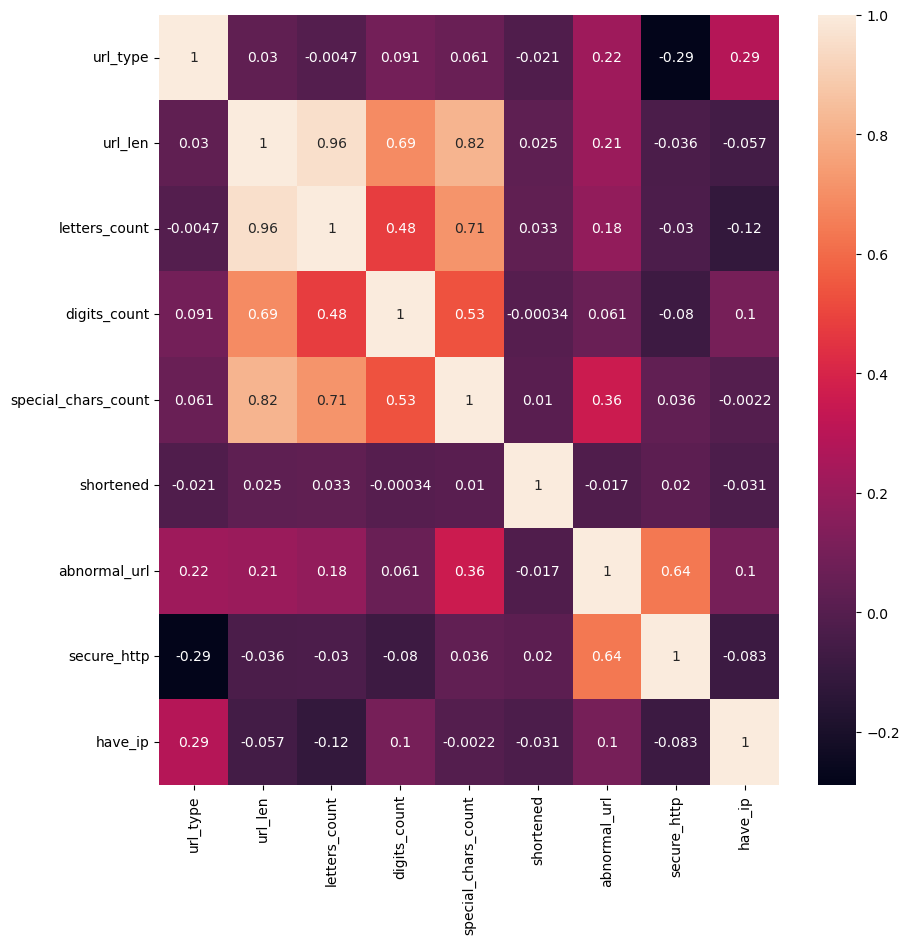

In [43]:
plt.figure(figsize=(10,10))
sns.heatmap(data.corr(),annot=True)
plt.plot()

In [44]:
data

,url,type,url_type,url_len,pri_domain,letters_count,digits_count,special_chars_count,shortened,abnormal_url,secure_http,have_ip
0,br-icloud.com.br,phishing,2,16,br-icloud.com.br,13,0,3,0,0,0,0
1,mp3raid.com/music/krizz_kaliko.html,benign,0,35,mp3raid.com,29,1,5,0,0,0,0
2,bopsecrets.org/rexroth/cr/1.htm,benign,0,31,bopsecrets.org,25,1,5,0,0,0,0
3,http://garage-pirenne.be/index.php?option=com_...,defacement,1,84,garage-pirenne.be,60,7,17,0,1,0,0
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1,235,adventure-nicaragua.net,199,22,14,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware,3,68,paypalsupports.com,42,18,8,0,1,0,0
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware,3,61,kids4mo.com,38,8,15,0,1,0,0
1048572,http://cbtechrepairs.com/secure/b/,malware,3,34,cbtechrepairs.com,27,0,7,0,1,0,0
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware,3,70,alpinebutterfly.com,58,1,11,0,1,0,0


In [45]:
def get_url_region(primary_domain):
    ccTLD_to_region = {
    ".ac": "Ascension Island",
    ".ad": "Andorra",
    ".ae": "United Arab Emirates",
    ".af": "Afghanistan",
    ".ag": "Antigua and Barbuda",
    ".ai": "Anguilla",
    ".al": "Albania",
    ".am": "Armenia",
    ".an": "Netherlands Antilles",
    ".ao": "Angola",
    ".aq": "Antarctica",
    ".ar": "Argentina",
    ".as": "American Samoa",
    ".at": "Austria",
    ".au": "Australia",
    ".aw": "Aruba",
    ".ax": "Åland Islands",
    ".az": "Azerbaijan",
    ".ba": "Bosnia and Herzegovina",
    ".bb": "Barbados",
    ".bd": "Bangladesh",
    ".be": "Belgium",
    ".bf": "Burkina Faso",
    ".bg": "Bulgaria",
    ".bh": "Bahrain",
    ".bi": "Burundi",
    ".bj": "Benin",
    ".bm": "Bermuda",
    ".bn": "Brunei Darussalam",
    ".bo": "Bolivia",
    ".br": "Brazil",
    ".bs": "Bahamas",
    ".bt": "Bhutan",
    ".bv": "Bouvet Island",
    ".bw": "Botswana",
    ".by": "Belarus",
    ".bz": "Belize",
    ".ca": "Canada",
    ".cc": "Cocos Islands",
    ".cd": "Democratic Republic of the Congo",
    ".cf": "Central African Republic",
    ".cg": "Republic of the Congo",
    ".ch": "Switzerland",
    ".ci": "Côte d'Ivoire",
    ".ck": "Cook Islands",
    ".cl": "Chile",
    ".cm": "Cameroon",
    ".cn": "China",
    ".co": "Colombia",
    ".cr": "Costa Rica",
    ".cu": "Cuba",
    ".cv": "Cape Verde",
    ".cw": "Curaçao",
    ".cx": "Christmas Island",
    ".cy": "Cyprus",
    ".cz": "Czech Republic",
    ".de": "Germany",
    ".dj": "Djibouti",
    ".dk": "Denmark",
    ".dm": "Dominica",
    ".do": "Dominican Republic",
    ".dz": "Algeria",
    ".ec": "Ecuador",
    ".ee": "Estonia",
    ".eg": "Egypt",
    ".er": "Eritrea",
    ".es": "Spain",
    ".et": "Ethiopia",
    ".eu": "European Union",
    ".fi": "Finland",
    ".fj": "Fiji",
    ".fk": "Falkland Islands",
    ".fm": "Federated States of Micronesia",
    ".fo": "Faroe Islands",
    ".fr": "France",
    ".ga": "Gabon",
    ".gb": "United Kingdom",
    ".gd": "Grenada",
    ".ge": "Georgia",
    ".gf": "French Guiana",
    ".gg": "Guernsey",
    ".gh": "Ghana",
    ".gi": "Gibraltar",
    ".gl": "Greenland",
    ".gm": "Gambia",
    ".gn": "Guinea",
    ".gp": "Guadeloupe",
    ".gq": "Equatorial Guinea",
    ".gr": "Greece",
    ".gs": "South Georgia and the South Sandwich Islands",
    ".gt": "Guatemala",
    ".gu": "Guam",
    ".gw": "Guinea-Bissau",
    ".gy": "Guyana",
    ".hk": "Hong Kong",
    ".hm": "Heard Island and McDonald Islands",
    ".hn": "Honduras",
    ".hr": "Croatia",
    ".ht": "Haiti",
    ".hu": "Hungary",
    ".id": "Indonesia",
    ".ie": "Ireland",
    ".il": "Israel",
    ".im": "Isle of Man",
    ".in": "India",
    ".io": "British Indian Ocean Territory",
    ".iq": "Iraq",
    ".ir": "Iran",
    ".is": "Iceland",
    ".it": "Italy",
    ".je": "Jersey",
    ".jm": "Jamaica",
    ".jo": "Jordan",
    ".jp": "Japan",
    ".ke": "Kenya",
    ".kg": "Kyrgyzstan",
    ".kh": "Cambodia",
    ".ki": "Kiribati",
    ".km": "Comoros",
    ".kn": "Saint Kitts and Nevis",
    ".kp": "Democratic People's Republic of Korea (North Korea)",
    ".kr": "Republic of Korea (South Korea)",
    ".kw": "Kuwait",
    ".ky": "Cayman Islands",
    ".kz": "Kazakhstan",
    ".la": "Laos",
    ".lb": "Lebanon",
    ".lc": "Saint Lucia",
    ".li": "Liechtenstein",
    ".lk": "Sri Lanka",
    ".lr": "Liberia",
    ".ls": "Lesotho",
    ".lt": "Lithuania",
    ".lu": "Luxembourg",
    ".lv": "Latvia",
    ".ly": "Libya",
    ".ma": "Morocco",
    ".mc": "Monaco",
    ".md": "Moldova",
    ".me": "Montenegro",
    ".mf": "Saint Martin (French part)",
    ".mg": "Madagascar",
    ".mh": "Marshall Islands",
    ".mk": "North Macedonia",
    ".ml": "Mali",
    ".mm": "Myanmar",
    ".mn": "Mongolia",
    ".mo": "Macao",
    ".mp": "Northern Mariana Islands",
    ".mq": "Martinique",
    ".mr": "Mauritania",
    ".ms": "Montserrat",
    ".mt": "Malta",
    ".mu": "Mauritius",
    ".mv": "Maldives",
    ".mw": "Malawi",
    ".mx": "Mexico",
    ".my": "Malaysia",
    ".mz": "Mozambique",
    ".na": "Namibia",
    ".nc": "New Caledonia",
    ".ne": "Niger",
    ".nf": "Norfolk Island",
    ".ng": "Nigeria",
    ".ni": "Nicaragua",
    ".nl": "Netherlands",
    ".no": "Norway",
    ".np": "Nepal",
    ".nr": "Nauru",
    ".nu": "Niue",
    ".nz": "New Zealand",
    ".om": "Oman",
    ".pa": "Panama",
    ".pe": "Peru",
    ".pf": "French Polynesia",
    ".pg": "Papua New Guinea",
    ".ph": "Philippines",
    ".pk": "Pakistan",
    ".pl": "Poland",
    ".pm": "Saint Pierre and Miquelon",
    ".pn": "Pitcairn",
    ".pr": "Puerto Rico",
    ".ps": "Palestinian Territory",
    ".pt": "Portugal",
    ".pw": "Palau",
    ".py": "Paraguay",
    ".qa": "Qatar",
    ".re": "Réunion",
    ".ro": "Romania",
    ".rs": "Serbia",
    ".ru": "Russia",
    ".rw": "Rwanda",
    ".sa": "Saudi Arabia",
    ".sb": "Solomon Islands",
    ".sc": "Seychelles",
    ".sd": "Sudan",
    ".se": "Sweden",
    ".sg": "Singapore",
    ".sh": "Saint Helena",
    ".si": "Slovenia",
    ".sj": "Svalbard and Jan Mayen",
    ".sk": "Slovakia",
    ".sl": "Sierra Leone",
    ".sm": "San Marino",
    ".sn": "Senegal",
    ".so": "Somalia",
    ".sr": "Suriname",
    ".ss": "South Sudan",
    ".st": "São Tomé and Príncipe",
    ".sv": "El Salvador",
    ".sx": "Sint Maarten (Dutch part)",
    ".sy": "Syria",
    ".sz": "Eswatini",
    ".tc": "Turks and Caicos Islands",
    ".td": "Chad",
    ".tf": "French Southern Territories",
    ".tg": "Togo",
    ".th": "Thailand",
    ".tj": "Tajikistan",
    ".tk": "Tokelau",
    ".tl": "Timor-Leste",
    ".tm": "Turkmenistan",
    ".tn": "Tunisia",
    ".to": "Tonga",
    ".tr": "Turkey",
    ".tt": "Trinidad and Tobago",
    ".tv": "Tuvalu",
    ".tw": "Taiwan",
    ".tz": "Tanzania",
    ".ua": "Ukraine",
    ".ug": "Uganda",
    ".uk": "United Kingdom",
    ".us": "United States",
    ".uy": "Uruguay",
    ".uz": "Uzbekistan",
    ".va": "Vatican City",
    ".vc": "Saint Vincent and the Grenadines",
    ".ve": "Venezuela",
    ".vg": "British Virgin Islands",
    ".vi": "U.S. Virgin Islands",
    ".vn": "Vietnam",
    ".vu": "Vanuatu",
    ".wf": "Wallis and Futuna",
    ".ws": "Samoa",
    ".ye": "Yemen",
    ".yt": "Mayotte",
    ".za": "South Africa",
    ".zm": "Zambia",
    ".zw": "Zimbabwe"
    }

    for ccTLD in ccTLD_to_region:
        if primary_domain.endswith(ccTLD):
            return ccTLD_to_region[ccTLD]

    return "Global"

In [46]:
data['url_region'] = data['pri_domain'].apply(lambda x: get_url_region(str(x)))

In [47]:
data

,url,type,url_type,url_len,pri_domain,letters_count,digits_count,special_chars_count,shortened,abnormal_url,secure_http,have_ip,url_region
0,br-icloud.com.br,phishing,2,16,br-icloud.com.br,13,0,3,0,0,0,0,Brazil
1,mp3raid.com/music/krizz_kaliko.html,benign,0,35,mp3raid.com,29,1,5,0,0,0,0,Global
2,bopsecrets.org/rexroth/cr/1.htm,benign,0,31,bopsecrets.org,25,1,5,0,0,0,0,Global
3,http://garage-pirenne.be/index.php?option=com_...,defacement,1,84,garage-pirenne.be,60,7,17,0,1,0,0,Belgium
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1,235,adventure-nicaragua.net,199,22,14,0,1,0,0,Global
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware,3,68,paypalsupports.com,42,18,8,0,1,0,0,Global
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware,3,61,kids4mo.com,38,8,15,0,1,0,0,Global
1048572,http://cbtechrepairs.com/secure/b/,malware,3,34,cbtechrepairs.com,27,0,7,0,1,0,0,Global
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware,3,70,alpinebutterfly.com,58,1,11,0,1,0,0,Global


In [48]:
def extract_root_domain(url):
    extracted = tldextract.extract(url)
    root_domain = extracted.domain
    return root_domain

In [49]:
data['root_domain'] = data['pri_domain'].apply(lambda x: extract_root_domain(str(x)))

In [50]:
data

,url,type,url_type,url_len,pri_domain,letters_count,digits_count,special_chars_count,shortened,abnormal_url,secure_http,have_ip,url_region,root_domain
0,br-icloud.com.br,phishing,2,16,br-icloud.com.br,13,0,3,0,0,0,0,Brazil,br-icloud
1,mp3raid.com/music/krizz_kaliko.html,benign,0,35,mp3raid.com,29,1,5,0,0,0,0,Global,mp3raid
2,bopsecrets.org/rexroth/cr/1.htm,benign,0,31,bopsecrets.org,25,1,5,0,0,0,0,Global,bopsecrets
3,http://garage-pirenne.be/index.php?option=com_...,defacement,1,84,garage-pirenne.be,60,7,17,0,1,0,0,Belgium,garage-pirenne
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1,235,adventure-nicaragua.net,199,22,14,0,1,0,0,Global,adventure-nicaragua
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048570,http://paypalsupports.com/ed32d6394dc0e1d861f9...,malware,3,68,paypalsupports.com,42,18,8,0,1,0,0,Global,paypalsupports
1048571,http://kids4mo.com/wp-includes/home.php?X4$55P...,malware,3,61,kids4mo.com,38,8,15,0,1,0,0,Global,kids4mo
1048572,http://cbtechrepairs.com/secure/b/,malware,3,34,cbtechrepairs.com,27,0,7,0,1,0,0,Global,cbtechrepairs
1048573,http://alpinebutterfly.com/templates/a4joomla-...,malware,3,70,alpinebutterfly.com,58,1,11,0,1,0,0,Global,alpinebutterfly


In [51]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 14 columns):
 #   Column               Non-Null Count    Dtype 
---  ------               --------------    ----- 
 0   url                  1048575 non-null  object
 1   type                 1048575 non-null  object
 2   url_type             1048575 non-null  int64 
 3   url_len              1048575 non-null  int64 
 4   pri_domain           1048575 non-null  object
 5   letters_count        1048575 non-null  int64 
 6   digits_count         1048575 non-null  int64 
 7   special_chars_count  1048575 non-null  int64 
 8   shortened            1048575 non-null  int64 
 9   abnormal_url         1048575 non-null  int64 
 10  secure_http          1048575 non-null  int64 
 11  have_ip              1048575 non-null  int64 
 12  url_region           1048575 non-null  object
 13  root_domain          1048575 non-null  object
dtypes: int64(9), object(5)
memory usage: 112.0+ MB


In [52]:
data.duplicated().sum()

13935

In [53]:
data.drop_duplicates(inplace=True)

In [54]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1034640 entries, 0 to 1048574
Data columns (total 14 columns):
 #   Column               Non-Null Count    Dtype 
---  ------               --------------    ----- 
 0   url                  1034640 non-null  object
 1   type                 1034640 non-null  object
 2   url_type             1034640 non-null  int64 
 3   url_len              1034640 non-null  int64 
 4   pri_domain           1034640 non-null  object
 5   letters_count        1034640 non-null  int64 
 6   digits_count         1034640 non-null  int64 
 7   special_chars_count  1034640 non-null  int64 
 8   shortened            1034640 non-null  int64 
 9   abnormal_url         1034640 non-null  int64 
 10  secure_http          1034640 non-null  int64 
 11  have_ip              1034640 non-null  int64 
 12  url_region           1034640 non-null  object
 13  root_domain          1034640 non-null  object
dtypes: int64(9), object(5)
memory usage: 118.4+ MB


In [55]:
data.head()

,url,type,url_type,url_len,pri_domain,letters_count,digits_count,special_chars_count,shortened,abnormal_url,secure_http,have_ip,url_region,root_domain
0,br-icloud.com.br,phishing,2,16,br-icloud.com.br,13,0,3,0,0,0,0,Brazil,br-icloud
1,mp3raid.com/music/krizz_kaliko.html,benign,0,35,mp3raid.com,29,1,5,0,0,0,0,Global,mp3raid
2,bopsecrets.org/rexroth/cr/1.htm,benign,0,31,bopsecrets.org,25,1,5,0,0,0,0,Global,bopsecrets
3,http://garage-pirenne.be/index.php?option=com_...,defacement,1,84,garage-pirenne.be,60,7,17,0,1,0,0,Belgium,garage-pirenne
4,http://adventure-nicaragua.net/index.php?optio...,defacement,1,235,adventure-nicaragua.net,199,22,14,0,1,0,0,Global,adventure-nicaragua


In [56]:
new_data = data.drop(columns=['url','type','pri_domain'])

In [57]:
new_data

,url_type,url_len,letters_count,digits_count,special_chars_count,shortened,abnormal_url,secure_http,have_ip,url_region,root_domain
0,2,16,13,0,3,0,0,0,0,Brazil,br-icloud
1,0,35,29,1,5,0,0,0,0,Global,mp3raid
2,0,31,25,1,5,0,0,0,0,Global,bopsecrets
3,1,84,60,7,17,0,1,0,0,Belgium,garage-pirenne
4,1,235,199,22,14,0,1,0,0,Global,adventure-nicaragua
...,...,...,...,...,...,...,...,...,...,...,...
1048567,3,33,24,2,7,0,1,0,0,Global,oderland
1048570,3,68,42,18,8,0,1,0,0,Global,paypalsupports
1048571,3,61,38,8,15,0,1,0,0,Global,kids4mo
1048573,3,70,58,1,11,0,1,0,0,Global,alpinebutterfly


In [58]:
new_data['root_domain'].value_counts()

wikipedia                                                   26304
facebook                                                    16623
blogspot                                                    15577
0                                                           14711
youtube                                                     11620
                                                            ...  
videogamershub                                                  1
cr-style                                                        1
services-runescape-m-forums-forum-ws-16-02-602-547945834        1
372891                                                          1
dfa1                                                            1
Name: root_domain, Length: 173769, dtype: int64

In [59]:
new_data = new_data[new_data['root_domain'] != '0']

In [60]:
new_data['root_domain'].value_counts()

wikipedia                                                   26304
facebook                                                    16623
blogspot                                                    15577
youtube                                                     11620
amazon                                                      10442
                                                            ...  
videogamershub                                                  1
cr-style                                                        1
services-runescape-m-forums-forum-ws-16-02-602-547945834        1
372891                                                          1
dfa1                                                            1
Name: root_domain, Length: 173768, dtype: int64

In [61]:
def hash_encode(category):
    hash_object = hashlib.md5(category.encode())
    return int(hash_object.hexdigest(), 16) % (10 ** 8)

In [62]:
new_data['root_domain'] = new_data['root_domain'].apply(hash_encode)

C:\Users\vrajp\AppData\Local\Temp\ipykernel_10096\253144694.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [63]:
new_data['url_region'] = new_data['url_region'].apply(hash_encode)

C:\Users\vrajp\AppData\Local\Temp\ipykernel_10096\3214126280.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [64]:
new_data

,url_type,url_len,letters_count,digits_count,special_chars_count,shortened,abnormal_url,secure_http,have_ip,url_region,root_domain
0,2,16,13,0,3,0,0,0,0,27739261,1310791
1,0,35,29,1,5,0,0,0,0,32604616,58335668
2,0,31,25,1,5,0,0,0,0,32604616,28611805
3,1,84,60,7,17,0,1,0,0,71484583,89045308
4,1,235,199,22,14,0,1,0,0,32604616,76838614
...,...,...,...,...,...,...,...,...,...,...,...
1048567,3,33,24,2,7,0,1,0,0,32604616,57754869
1048570,3,68,42,18,8,0,1,0,0,32604616,31450481
1048571,3,61,38,8,15,0,1,0,0,32604616,11425792
1048573,3,70,58,1,11,0,1,0,0,32604616,85480101


In [65]:
x = new_data.drop(columns=['url_type'])
y = new_data['url_type']
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.2, random_state=42)

In [66]:
print(f"X_train Shape : {x_train.shape}")
print(f"Y_train Shape : {y_train.shape}")
print(f"X_test  Shape : {x_test.shape}")
print(f"Y_test  Shape : {y_test.shape}")

X_train Shape : (815943, 10)
Y_train Shape : (815943,)
X_test  Shape : (203986, 10)
Y_test  Shape : (203986,)


In [83]:
clf = DecisionTreeClassifier()

results = []

clf.fit(x_train, y_train)
tree_text = export_text(clf, feature_names=list(x_train.columns))
print("Decision Tree:\n", tree_text)

Decision Tree:
 |--- secure_http <= 0.50
|   |--- abnormal_url <= 0.50
|   |   |--- special_chars_count <= 1.50
|   |   |   |--- digits_count <= 2.50
|   |   |   |   |--- url_region <= 74920756.00
|   |   |   |   |   |--- url_region <= 25940705.00
|   |   |   |   |   |   |--- url_region <= 16328656.00
|   |   |   |   |   |   |   |--- root_domain <= 233386.00
|   |   |   |   |   |   |   |   |--- class: 3
|   |   |   |   |   |   |   |--- root_domain >  233386.00
|   |   |   |   |   |   |   |   |--- letters_count <= 5.50
|   |   |   |   |   |   |   |   |   |--- root_domain <= 91907124.00
|   |   |   |   |   |   |   |   |   |   |--- class: 2
|   |   |   |   |   |   |   |   |   |--- root_domain >  91907124.00
|   |   |   |   |   |   |   |   |   |   |--- class: 3
|   |   |   |   |   |   |   |   |--- letters_count >  5.50
|   |   |   |   |   |   |   |   |   |--- url_region <= 8679532.00
|   |   |   |   |   |   |   |   |   |   |--- url_region <= 2909112.00
|   |   |   |   |   |   |   |   |   |

In [84]:
y_pred = clf.predict(x_test)

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, output_dict=True)
f1_score = report['macro avg']['f1-score']
precision = report['macro avg']['precision']
recall = report['macro avg']['recall']

results.append({
    'Model': type(clf).__name__,
    'Accuracy': accuracy,
    'F1-Score': f1_score,
    'Precision': precision,
    'Recall': recall
    })

print("Test Accuracy: " , accuracy * 100)

Test Accuracy:  90.4508152520271


In [179]:
print(classification_report(y_test, y_pred))  

              precision    recall  f1-score   support

           0       0.96      0.96      0.96    152010
           1       0.89      0.92      0.90     18976
           2       0.60      0.60      0.60     18869
           3       0.75      0.72      0.74     14131

    accuracy                           0.90    203986
   macro avg       0.80      0.80      0.80    203986
weighted avg       0.90      0.90      0.90    203986



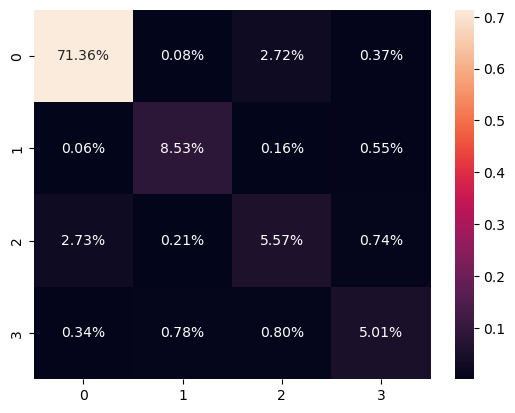

In [180]:
cf_matrix = confusion_matrix(y_test, y_pred)
plot_ = sns.heatmap(cf_matrix / np.sum(cf_matrix), annot=True, fmt='0.2%')
plt.show()

In [182]:
import pickle  

In [183]:
model=clf
filename="url_model.pkl"

In [184]:
pickle.dump(model,open(filename, 'wb'))

In [206]:
def extract_features(url):
    
    def extract_url_length(url):
        return len(url)
    
    def extract_count_letters(url):
        num_letters = sum(char.isalpha() for char in url)
        return num_letters

    def extract_count_digits(url):
        num_digits = sum(char.isdigit() for char in url)
        return num_digits
    
    def extract_count_special_chars(url):
        special_chars = "!@#$%^&*()_+-=[]{};:,.<>/?`~|"
        num_special_chars = sum(char in special_chars for char in url)
        return num_special_chars
    
    def extract_abnormal_url(url):
        parsed_url = urlparse(url)
        hostname = parsed_url.hostname
        if hostname:
            hostname = str(hostname)
            match = re.search(hostname, url)
            if match:
                return 1
        return 0
    
    def extract_have_ip_address(url):
        pattern = r'(([01]?\d\d?|2[0-4]\d|25[0-5])\.([01]?\d\d?|2[0-4]\d|25[0-5])\.([01]?\d\d?|2[0-4]\d|25[0-5])\.' \
                  r'([01]?\d\d?|2[0-4]\d|25[0-5])\/)|' \
                  r'(([01]?\d\d?|2[0-4]\d|25[0-5])\.([01]?\d\d?|2[0-4]\d|25[0-5])\.([01]?\d\d?|2[0-4]\d|25[0-5])\.' \
                  r'([01]?\d\d?|2[0-4]\d|25[0-5])\/)|' \
                  r'((0x[0-9a-fA-F]{1,2})\.(0x[0-9a-fA-F]{1,2})\.(0x[0-9a-fA-F]{1,2})\.(0x[0-9a-fA-F]{1,2})\/)' \
                  r'(?:[a-fA-F0-9]{1,4}:){7}[a-fA-F0-9]{1,4}|' \
                  r'([0-9]+(?:\.[0-9]+){3}:[0-9]+)|' \
                  r'((?:(?:\d|[01]?\d\d|2[0-4]\d|25[0-5])\.){3}(?:25[0-5]|2[0-4]\d|[01]?\d\d|\d)(?:\/\d{1,2})?)'

        match = re.search(pattern, url)
        if match:
            return 1
        else:
            return 0
        
    def extract_secure_http(url):
        scheme = urlparse(url).scheme
        if scheme == 'https':
            return 1
        else:
            return 0
        
    def extract_has_shortening_service(url):
        pattern = re.compile(r'bit\.ly|goo\.gl|shorte\.st|go2l\.ink|x\.co|ow\.ly|t\.co|tinyurl|tr\.im|is\.gd|cli\.gs|'
                             r'yfrog\.com|migre\.me|ff\.im|tiny\.cc|url4\.eu|twit\.ac|su\.pr|twurl\.nl|snipurl\.com|'
                             r'short\.to|BudURL\.com|ping\.fm|post\.ly|Just\.as|bkite\.com|snipr\.com|fic\.kr|loopt\.us|'
                             r'doiop\.com|short\.ie|kl\.am|wp\.me|rubyurl\.com|om\.ly|to\.ly|bit\.do|t\.co|lnkd\.in|'
                             r'db\.tt|qr\.ae|adf\.ly|goo\.gl|bitly\.com|cur\.lv|tinyurl\.com|ow\.ly|bit\.ly|ity\.im|'
                             r'q\.gs|is\.gd|po\.st|bc\.vc|twitthis\.com|u\.to|j\.mp|buzurl\.com|cutt\.us|u\.bb|yourls\.org|'
                             r'x\.co|prettylinkpro\.com|scrnch\.me|filoops\.info|vzturl\.com|qr\.net|1url\.com|tweez\.me|v\.gd|'
                             r'tr\.im|link\.zip\.net')
        match = pattern.search(url)
        return int(bool(match))

    def extract_root_domain(url):
        extracted = tldextract.extract(url)
        root_domain = extracted.domain
        return root_domain

    def get_url_region(primary_domain):
      ccTLD_to_region = {
      ".ac": "Ascension Island",
      ".ad": "Andorra",
      ".ae": "United Arab Emirates",
      ".af": "Afghanistan",
      ".ag": "Antigua and Barbuda",
      ".ai": "Anguilla",
      ".al": "Albania",
      ".am": "Armenia",
      ".an": "Netherlands Antilles",
      ".ao": "Angola",
      ".aq": "Antarctica",
      ".ar": "Argentina",
      ".as": "American Samoa",
      ".at": "Austria",
      ".au": "Australia",
      ".aw": "Aruba",
      ".ax": "Åland Islands",
      ".az": "Azerbaijan",
      ".ba": "Bosnia and Herzegovina",
      ".bb": "Barbados",
      ".bd": "Bangladesh",
      ".be": "Belgium",
      ".bf": "Burkina Faso",
      ".bg": "Bulgaria",
      ".bh": "Bahrain",
      ".bi": "Burundi",
      ".bj": "Benin",
      ".bm": "Bermuda",
      ".bn": "Brunei Darussalam",
      ".bo": "Bolivia",
      ".br": "Brazil",
      ".bs": "Bahamas",
      ".bt": "Bhutan",
      ".bv": "Bouvet Island",
      ".bw": "Botswana",
      ".by": "Belarus",
      ".bz": "Belize",
      ".ca": "Canada",
      ".cc": "Cocos Islands",
      ".cd": "Democratic Republic of the Congo",
      ".cf": "Central African Republic",
      ".cg": "Republic of the Congo",
      ".ch": "Switzerland",
      ".ci": "Côte d'Ivoire",
      ".ck": "Cook Islands",
      ".cl": "Chile",
      ".cm": "Cameroon",
      ".cn": "China",
      ".co": "Colombia",
      ".cr": "Costa Rica",
      ".cu": "Cuba",
      ".cv": "Cape Verde",
      ".cw": "Curaçao",
      ".cx": "Christmas Island",
      ".cy": "Cyprus",
      ".cz": "Czech Republic",
      ".de": "Germany",
      ".dj": "Djibouti",
      ".dk": "Denmark",
      ".dm": "Dominica",
      ".do": "Dominican Republic",
      ".dz": "Algeria",
      ".ec": "Ecuador",
      ".ee": "Estonia",
      ".eg": "Egypt",
      ".er": "Eritrea",
      ".es": "Spain",
      ".et": "Ethiopia",
      ".eu": "European Union",
      ".fi": "Finland",
      ".fj": "Fiji",
      ".fk": "Falkland Islands",
      ".fm": "Federated States of Micronesia",
      ".fo": "Faroe Islands",
      ".fr": "France",
      ".ga": "Gabon",
      ".gb": "United Kingdom",
      ".gd": "Grenada",
      ".ge": "Georgia",
      ".gf": "French Guiana",
      ".gg": "Guernsey",
      ".gh": "Ghana",
      ".gi": "Gibraltar",
      ".gl": "Greenland",
      ".gm": "Gambia",
      ".gn": "Guinea",
      ".gp": "Guadeloupe",
      ".gq": "Equatorial Guinea",
      ".gr": "Greece",
      ".gs": "South Georgia and the South Sandwich Islands",
      ".gt": "Guatemala",
      ".gu": "Guam",
      ".gw": "Guinea-Bissau",
      ".gy": "Guyana",
      ".hk": "Hong Kong",
      ".hm": "Heard Island and McDonald Islands",
      ".hn": "Honduras",
      ".hr": "Croatia",
      ".ht": "Haiti",
      ".hu": "Hungary",
      ".id": "Indonesia",
      ".ie": "Ireland",
      ".il": "Israel",
      ".im": "Isle of Man",
      ".in": "India",
      ".io": "British Indian Ocean Territory",
      ".iq": "Iraq",
      ".ir": "Iran",
      ".is": "Iceland",
      ".it": "Italy",
      ".je": "Jersey",
      ".jm": "Jamaica",
      ".jo": "Jordan",
      ".jp": "Japan",
      ".ke": "Kenya",
      ".kg": "Kyrgyzstan",
      ".kh": "Cambodia",
      ".ki": "Kiribati",
      ".km": "Comoros",
      ".kn": "Saint Kitts and Nevis",
      ".kp": "Democratic People's Republic of Korea (North Korea)",
      ".kr": "Republic of Korea (South Korea)",
      ".kw": "Kuwait",
      ".ky": "Cayman Islands",
      ".kz": "Kazakhstan",
      ".la": "Laos",
      ".lb": "Lebanon",
      ".lc": "Saint Lucia",
      ".li": "Liechtenstein",
      ".lk": "Sri Lanka",
      ".lr": "Liberia",
      ".ls": "Lesotho",
      ".lt": "Lithuania",
      ".lu": "Luxembourg",
      ".lv": "Latvia",
      ".ly": "Libya",
      ".ma": "Morocco",
      ".mc": "Monaco",
      ".md": "Moldova",
      ".me": "Montenegro",
      ".mf": "Saint Martin (French part)",
      ".mg": "Madagascar",
      ".mh": "Marshall Islands",
      ".mk": "North Macedonia",
      ".ml": "Mali",
      ".mm": "Myanmar",
      ".mn": "Mongolia",
      ".mo": "Macao",
      ".mp": "Northern Mariana Islands",
      ".mq": "Martinique",
      ".mr": "Mauritania",
      ".ms": "Montserrat",
      ".mt": "Malta",
      ".mu": "Mauritius",
      ".mv": "Maldives",
      ".mw": "Malawi",
      ".mx": "Mexico",
      ".my": "Malaysia",
      ".mz": "Mozambique",
      ".na": "Namibia",
      ".nc": "New Caledonia",
      ".ne": "Niger",
      ".nf": "Norfolk Island",
      ".ng": "Nigeria",
      ".ni": "Nicaragua",
      ".nl": "Netherlands",
      ".no": "Norway",
      ".np": "Nepal",
      ".nr": "Nauru",
      ".nu": "Niue",
      ".nz": "New Zealand",
      ".om": "Oman",
      ".pa": "Panama",
      ".pe": "Peru",
      ".pf": "French Polynesia",
      ".pg": "Papua New Guinea",
      ".ph": "Philippines",
      ".pk": "Pakistan",
      ".pl": "Poland",
      ".pm": "Saint Pierre and Miquelon",
      ".pn": "Pitcairn",
      ".pr": "Puerto Rico",
      ".ps": "Palestinian Territory",
      ".pt": "Portugal",
      ".pw": "Palau",
      ".py": "Paraguay",
      ".qa": "Qatar",
      ".re": "Réunion",
      ".ro": "Romania",
      ".rs": "Serbia",
      ".ru": "Russia",
      ".rw": "Rwanda",
      ".sa": "Saudi Arabia",
      ".sb": "Solomon Islands",
      ".sc": "Seychelles",
      ".sd": "Sudan",
      ".se": "Sweden",
      ".sg": "Singapore",
      ".sh": "Saint Helena",
      ".si": "Slovenia",
      ".sj": "Svalbard and Jan Mayen",
      ".sk": "Slovakia",
      ".sl": "Sierra Leone",
      ".sm": "San Marino",
      ".sn": "Senegal",
      ".so": "Somalia",
      ".sr": "Suriname",
      ".ss": "South Sudan",
      ".st": "São Tomé and Príncipe",
      ".sv": "El Salvador",
      ".sx": "Sint Maarten (Dutch part)",
      ".sy": "Syria",
      ".sz": "Eswatini",
      ".tc": "Turks and Caicos Islands",
      ".td": "Chad",
      ".tf": "French Southern Territories",
      ".tg": "Togo",
      ".th": "Thailand",
      ".tj": "Tajikistan",
      ".tk": "Tokelau",
      ".tl": "Timor-Leste",
      ".tm": "Turkmenistan",
      ".tn": "Tunisia",
      ".to": "Tonga",
      ".tr": "Turkey",
      ".tt": "Trinidad and Tobago",
      ".tv": "Tuvalu",
      ".tw": "Taiwan",
      ".tz": "Tanzania",
      ".ua": "Ukraine",
      ".ug": "Uganda",
      ".uk": "United Kingdom",
      ".us": "United States",
      ".uy": "Uruguay",
      ".uz": "Uzbekistan",
      ".va": "Vatican City",
      ".vc": "Saint Vincent and the Grenadines",
      ".ve": "Venezuela",
      ".vg": "British Virgin Islands",
      ".vi": "U.S. Virgin Islands",
      ".vn": "Vietnam",
      ".vu": "Vanuatu",
      ".wf": "Wallis and Futuna",
      ".ws": "Samoa",
      ".ye": "Yemen",
      ".yt": "Mayotte",
      ".za": "South Africa",
      ".zm": "Zambia",
      ".zw": "Zimbabwe"
      }

      for ccTLD in ccTLD_to_region:
          if primary_domain.endswith(ccTLD):
              return ccTLD_to_region[ccTLD]

      return "Global"
    
    url = url.replace('www.', '')
    url_len = extract_url_length(url)
    letters_count = extract_count_letters(url)
    digits_count = extract_count_digits(url)
    special_chars_count = extract_count_special_chars(url)
    abnormal_url = extract_abnormal_url(url)
    have_ip = extract_have_ip_address(url)
    secure_http = extract_secure_http(url)
    shortened = extract_has_shortening_service(url)
    pri_domain = extract_pri_domain(url)
    
    root_domain = extract_root_domain(str(pri_domain))
    root_domain = hash_encode(root_domain)

    url_region = get_url_region(str(pri_domain))
    url_region = hash_encode(url_region)

    return pd.DataFrame({
        'url_len': [url_len],
        'letters_count': [letters_count],
        'digits_count': [digits_count],
        'special_chars_count': [special_chars_count],
        'shortened': [shortened],
        'abnormal_url': [abnormal_url],
        'secure_http': [secure_http],
        'have_ip': [have_ip],
        'url_region': [url_region],
        'root_domain': [root_domain]
    })

In [209]:
clf = DecisionTreeClassifier()
clf.fit(x_train, y_train)

user_url = "https://www.google.com"

user_url_data = extract_features(user_url)

model = pickle.load(open('url_model.pkl', 'rb'))
output=model.predict(user_url_data)

url_type_mapping = {
    0: 'benign',
    1: 'defacement',
    2: 'phishing',
    3: 'malware'
}

predicted_url_type = url_type_mapping.get(output[0])

print(f"Predicted URL Type: {predicted_url_type}")

Predicted URL Type: benign


In [201]:
!pip show sklearn

Name: sklearn
Version: 0.0.post10
Summary: deprecated sklearn package, use scikit-learn instead
Home-page: 
Author: 
Author-email: 
License: 
Location: D:\Anaconda\Lib\site-packages
Requires: 
Required-by: 
Note: you may need to restart the kernel to use updated packages.


In [205]:
import sklearn
print(sklearn. __version__) 

1.3.0
